In [ ]:
importimportimport kagglehub

# Download latest version
path = kagglehub.dataset_download("younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal")

print("Path to dataset files:", path)

100%|██████████| 12.9M/12.9M [00:00<00:00, 156MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1


In [ ]:
import os

print(f"📂 Dataset location: {path}")
print(f"\n📊 Contents:")

# সব files count করুন
total_files = 0
for root, dirs, files in os.walk(path):
    total_files += len(files)
    print(f"  {os.path.basename(root)}: {len(files)} files")

print(f"\n✅ Total files: {total_files}")

📂 Dataset location: /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1

📊 Contents:
  1: 0 files
  Coronary_Artery: 0 files
  Dataset: 0 files
  normal: 127 files
  abnormal: 78 files

✅ Total files: 205


📂 Exploring dataset structure...

📁 /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1

📁 /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1/Coronary_Artery

📁 /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1/Coronary_Artery/Dataset

📁 /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1/Coronary_Artery/Dataset/normal
   Files: 127
   - normal i11_004.jpg
   - normal i11_003.jpg
   - normal i2_005.jpg
   - normal e_005.jpg
   - normal col_003.jpg
   ... and 122 more

📁 /root/.cache/kagglehub/datasets/younesselbrag/coronary-artery-diseaes-dataset-normal-abnormal/versions/1/Coronary_Artery/Dataset/abnormal
   Files: 78
   - abnormal k_003.jpg
   - abnormal k1_002.jpg
   - abnormal g_001.jpg
   - abnormal f_006.jpg
   - abnormal h_001.jpg
   ... and 73 more


🖼️ Showing sample

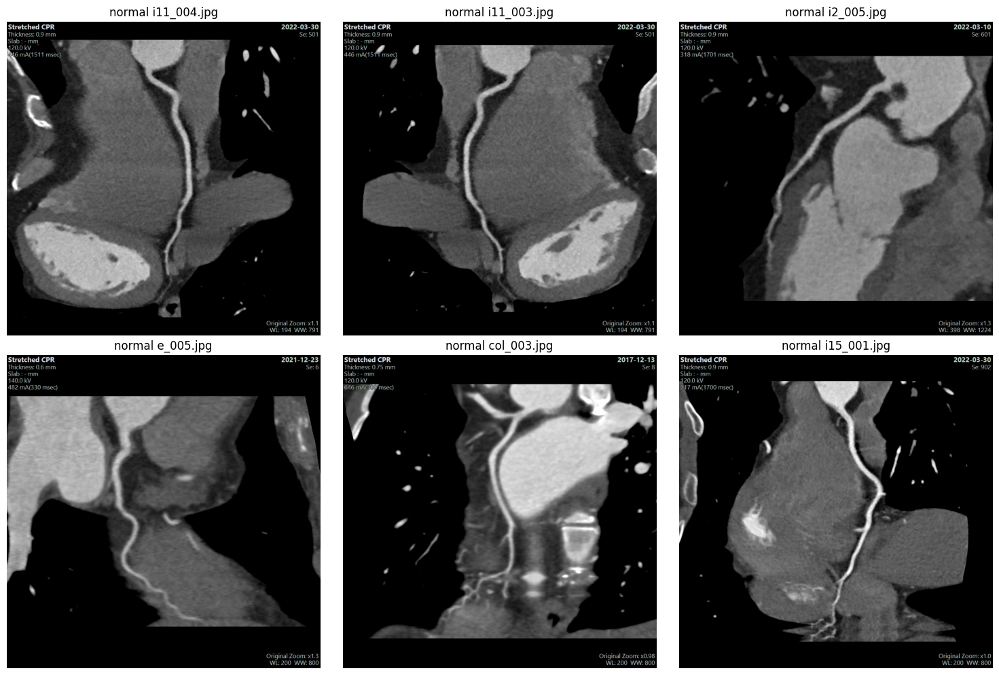

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# প্রথমে দেখি কী কী আছে
print("📂 Exploring dataset structure...\n")
for root, dirs, files in os.walk(path):
    print(f"📁 {root}")
    if files:
        print(f"   Files: {len(files)}")
        # প্রথম 5টা file name দেখাই
        for f in files[:5]:
            print(f"   - {f}")
        if len(files) > 5:
            print(f"   ... and {len(files)-5} more")
    print()

# এখন images দেখি
print("\n🖼️ Showing sample images...\n")

# সব image files খুঁজে বের করি
image_files = []
for root, dirs, files in os.walk(path):
    for file in files:
        if file.lower().endswith(('.png', '.jpg', '.jpeg', '.dcm', '.nii', '.nii.gz')):
            image_files.append(os.path.join(root, file))

print(f"Total images found: {len(image_files)}")

# প্রথম কয়েকটা image দেখাই
if len(image_files) > 0:
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    axes = axes.flatten()

    for i in range(min(6, len(image_files))):
        try:
            img = Image.open(image_files[i])
            axes[i].imshow(img, cmap='gray')
            axes[i].set_title(os.path.basename(image_files[i]))
            axes[i].axis('off')
        except Exception as e:
            axes[i].text(0.5, 0.5, f'Error loading image', ha='center')
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("❌ No image files found!")

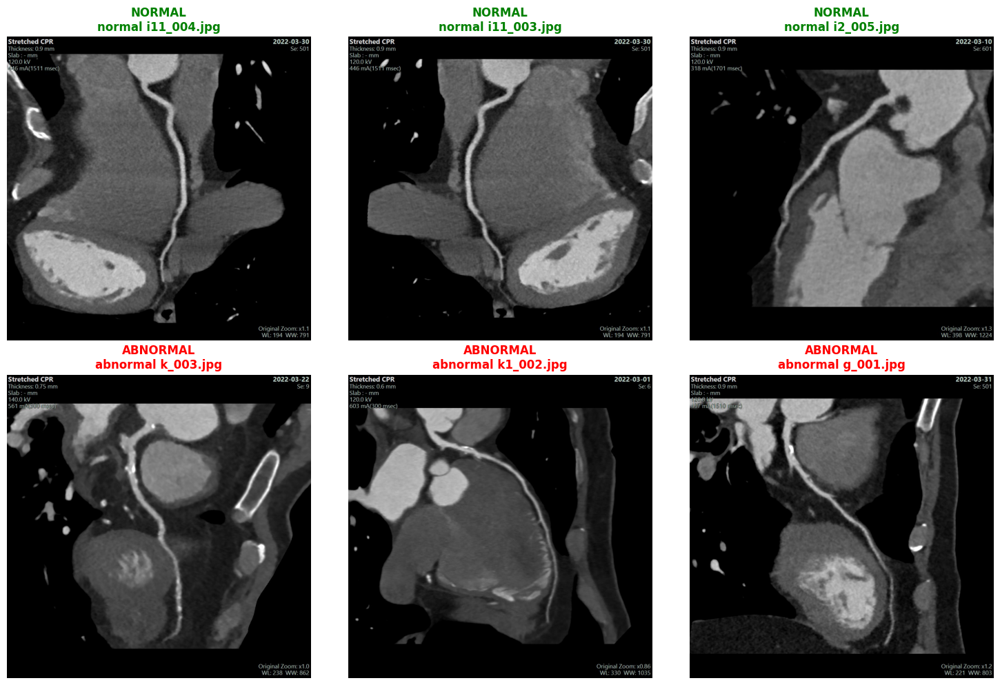


📊 DATASET SUMMARY
✅ Normal images: 127 files
❌ Abnormal images: 78 files
📦 Total: 205 images


In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Dataset path
dataset_path = os.path.join(path, "Coronary_Artery/Dataset")
normal_path = os.path.join(dataset_path, "normal")
abnormal_path = os.path.join(dataset_path, "abnormal")

# Normal এবং Abnormal থেকে কিছু images নিই
normal_images = [os.path.join(normal_path, f) for f in os.listdir(normal_path) if f.endswith('.jpg')][:3]
abnormal_images = [os.path.join(abnormal_path, f) for f in os.listdir(abnormal_path) if f.endswith('.jpg')][:3]

# Plot করি
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Normal images (উপরের row)
for i in range(3):
    img = Image.open(normal_images[i])
    axes[0, i].imshow(img, cmap='gray')
    axes[0, i].set_title(f'NORMAL\n{os.path.basename(normal_images[i])}', color='green', fontsize=12, fontweight='bold')
    axes[0, i].axis('off')

# Abnormal images (নিচের row)
for i in range(3):
    img = Image.open(abnormal_images[i])
    axes[1, i].imshow(img, cmap='gray')
    axes[1, i].set_title(f'ABNORMAL\n{os.path.basename(abnormal_images[i])}', color='red', fontsize=12, fontweight='bold')
    axes[1, i].axis('off')

plt.tight_layout()
plt.show()

# Dataset summary
print("\n" + "="*60)
print("📊 DATASET SUMMARY")
print("="*60)
print(f"✅ Normal images: {len(os.listdir(normal_path))} files")
print(f"❌ Abnormal images: {len(os.listdir(abnormal_path))} files")
print(f"📦 Total: {len(os.listdir(normal_path)) + len(os.listdir(abnormal_path))} images")
print("="*60)

⚙️ DATA PREPROCESSING SETUP
Image size: (224, 224)
Batch size: 32
Augmentation: Rotation, Flip, Zoom, Brightness
Found 175 images belonging to 2 classes.
Found 30 images belonging to 2 classes.

✅ Training samples: 175
✅ Validation samples: 30
✅ Classes: {'abnormal': 0, 'normal': 1}


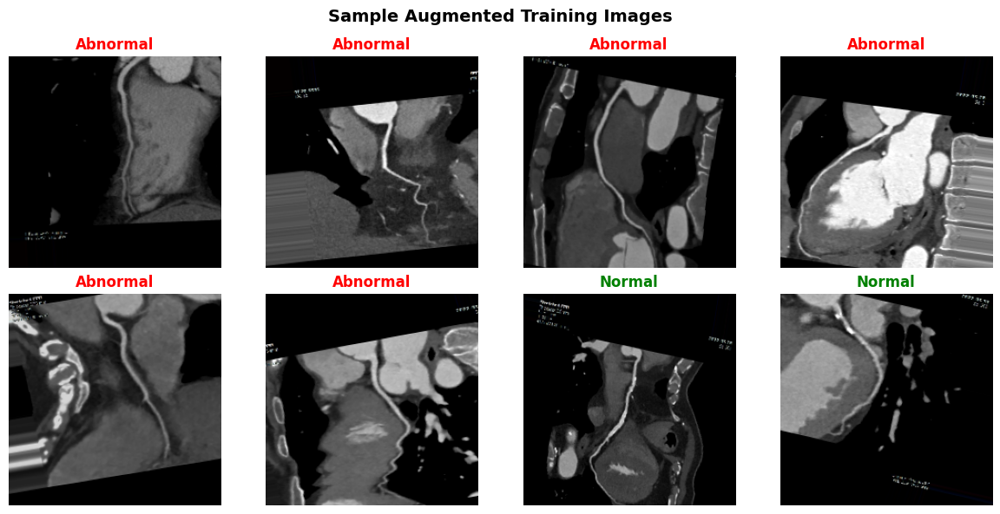


✅ STEP 1 COMPLETE: Data Preprocessing Done!

Next: Step 2 - Build Models (Transfer Learning + Custom CNN)


In [ ]:
# ============================================================================
# STEP 1: DATA PREPROCESSING & AUGMENTATION
# Purpose: Prepare images for training with data augmentation techniques
# ============================================================================

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Configuration parameters
IMG_SIZE = (224, 224)  # Standard size for pre-trained models
BATCH_SIZE = 32        # Number of images per batch
SEED = 42              # For reproducibility

print("⚙️ DATA PREPROCESSING SETUP")
print("="*60)
print(f"Image size: {IMG_SIZE}")
print(f"Batch size: {BATCH_SIZE}")
print(f"Augmentation: Rotation, Flip, Zoom, Brightness")
print("="*60)

# ============================================================================
# Data Augmentation Generator
# - rescale: Normalize pixel values from [0, 255] to [0, 1]
# - rotation_range: Randomly rotate images by ±20 degrees
# - width/height_shift: Shift images horizontally/vertically by 20%
# - horizontal_flip: Random horizontal flipping
# - zoom_range: Random zoom in/out by 20%
# - brightness_range: Adjust brightness between 80% to 120%
# - validation_split: Reserve 15% data for validation
# ============================================================================
train_datagen = ImageDataGenerator(
    rescale=1./255,                    # Normalize pixels to [0,1]
    rotation_range=20,                 # Rotate ±20 degrees
    width_shift_range=0.2,             # Horizontal shift
    height_shift_range=0.2,            # Vertical shift
    horizontal_flip=True,              # Random flip
    zoom_range=0.2,                    # Zoom in/out
    brightness_range=[0.8, 1.2],       # Brightness adjustment
    validation_split=0.15              # 15% for validation
)

# ============================================================================
# Load Training Data (85% of total data)
# flow_from_directory automatically labels based on folder names
# ============================================================================
train_generator = train_datagen.flow_from_directory(
    dataset_path,                      # Path to dataset
    target_size=IMG_SIZE,              # Resize all images
    batch_size=BATCH_SIZE,             # Images per batch
    class_mode='binary',               # Binary classification (0/1)
    subset='training',                 # Training subset
    seed=SEED,                         # Reproducibility
    shuffle=True                       # Shuffle training data
)

# ============================================================================
# Load Validation Data (15% of total data)
# No shuffling for validation to ensure consistent evaluation
# ============================================================================
validation_generator = train_datagen.flow_from_directory(
    dataset_path,                      # Path to dataset
    target_size=IMG_SIZE,              # Resize all images
    batch_size=BATCH_SIZE,             # Images per batch
    class_mode='binary',               # Binary classification
    subset='validation',               # Validation subset
    seed=SEED,                         # Reproducibility
    shuffle=False                      # Don't shuffle validation
)

# ============================================================================
# Display Data Split Information
# ============================================================================
print(f"\n✅ Training samples: {train_generator.samples}")
print(f"✅ Validation samples: {validation_generator.samples}")
print(f"✅ Classes: {train_generator.class_indices}")
# class_indices shows mapping: {'abnormal': 0, 'normal': 1} or similar

# ============================================================================
# VISUALIZE AUGMENTED SAMPLES
# Purpose: Show how augmentation transforms original images
# This helps verify that augmentation is working correctly
# ============================================================================
fig, axes = plt.subplots(2, 4, figsize=(12, 6))
axes = axes.flatten()

# Get one batch of augmented images
sample_batch = next(train_generator)
sample_images = sample_batch[0][:8]   # First 8 images
sample_labels = sample_batch[1][:8]   # Their labels

# Plot each image with its label
for i in range(8):
    axes[i].imshow(sample_images[i])
    # Determine label (depends on class_indices mapping)
    label = "Normal" if sample_labels[i] == 0 else "Abnormal"
    color = "green" if sample_labels[i] == 0 else "red"
    axes[i].set_title(label, color=color, fontweight='bold')
    axes[i].axis('off')

plt.suptitle('Sample Augmented Training Images', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

print("\n" + "="*60)
print("✅ STEP 1 COMPLETE: Data Preprocessing Done!")
print("="*60)
print("\nNext: Step 2 - Build Models (Transfer Learning + Custom CNN)")

In [ ]:
# ============================================================================
# STEP 2: MODEL ARCHITECTURE
# Purpose: Build two models for comparison
# 1. Transfer Learning (ResNet50) - Pre-trained on ImageNet
# 2. Custom CNN - Built from scratch
# ============================================================================

from tensorflow.keras import layers, models
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.optimizers import Adam

print("🧠 STEP 2: MODEL BUILDING")
print("="*60)

# ============================================================================
# MODEL 1: TRANSFER LEARNING (ResNet50)
# Why ResNet50?
# - Pre-trained on ImageNet (1.4M images)
# - Proven architecture for medical imaging
# - Faster training due to pre-learned features
# ============================================================================

print("\n🔹 Building Transfer Learning Model (ResNet50)...")

# Load pre-trained ResNetResNetResNetResNet50 (without top classification layer)
base_modelResNetResNetmodelResNetResNetmodelResNetResNetmodelResNetResNetResNetmodelResNetResNetmodelResNetResNetResNetmodelResNetResNetmodelResNetResNet
    weights='imagenet',           # Use ImageNet pre-trained weights
    include_top=False,            # Remove original classification layer
    input_shape=(224, 224, 3)     # Our input image size
)

# Freeze base model layers (don't retrain them initially)
base_model.trainable = False

# Build complete model
transfer_model = models.Sequential([
    base_model,                                    # Pre-trained ResNet50
    layers.GlobalAveragePooling2D(),              # Convert to 1D vector
    layers.Dense(256, activation='relu'),         # Hidden layer 1
    layers.Dropout(0.5),                          # Prevent overfitting
    layers.Dense(128, activation='relu'),         # Hidden layer 2
    layers.Dropout(0.3),                          # Prevent overfitting
    layers.Dense(1, activation='sigmoid')         # Output: 0 or 1
], name='Transfer_Learning_ResNet50')

print("✅ Transfer Learning Model Created!")
print(f"   - Total parameters: {transfer_model.count_params():,}")
print(f"   - Trainable parameters: {sum([tf.size(w).numpy() for w in transfer_model.trainable_weights]):,}")

# ============================================================================
# MODEL 2: CUSTOM CNN (Built from scratch)
# Architecture: 4 Convolutional blocks + Dense layers
# Purpose: Compare with transfer learning approach
# ============================================================================

print("\n🔹 Building Custom CNN Model...")

custom_cnn = models.Sequential([
    # Block 1: 32 filters
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.BatchNormalization(),                  # Normalize activations
    layers.MaxPooling2D((2, 2)),                  # Reduce size by half

    # Block 2: 64 filters
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),

    # Block 3: 128 filters
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),

    # Block 4: 256 filters
    layers.Conv2D(256, (3, 3), activation='relu'),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),

    # Fully connected layers
    layers.Flatten(),                             # Convert 2D to 1D
    layers.Dense(512, activation='relu'),         # Hidden layer 1
    layers.Dropout(0.5),                          # Dropout 50%
    layers.Dense(256, activation='relu'),         # Hidden layer 2
    layers.Dropout(0.3),                          # Dropout 30%
    layers.Dense(1, activation='sigmoid')         # Output layer
], name='Custom_CNN')

print("✅ Custom CNN Model Created!")
print(f"   - Total parameters: {custom_cnn.count_params():,}")

# ============================================================================
# COMPILE BOTH MODELS
# Optimizer: Adam (adaptive learning rate)
# Loss: Binary Cross-Entropy (for binary classification)
# Metrics: Accuracy, Precision, Recall
# ============================================================================

print("\n⚙️ Compiling Models...")

# Compile Transfer Learning Model
transfer_model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy',
             tf.keras.metrics.Precision(name='precision'),
             tf.keras.metrics.Recall(name='recall')]
)

# Compile Custom CNN Model
custom_cnn.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy',
             tf.keras.metrics.Precision(name='precision'),
             tf.keras.metrics.Recall(name='recall')]
)

print("✅ Both models compiled successfully!")

# ============================================================================
# MODEL SUMMARIES
# ============================================================================

print("\n" + "="*60)
print("📋 TRANSFER LEARNING MODEL SUMMARY")
print("="*60)
transfer_model.summary()

print("\n" + "="*60)
print("📋 CUSTOM CNN MODEL SUMMARY")
print("="*60)
custom_cnn.summary()

print("\n" + "="*60)
print("✅ STEP 2 COMPLETE: Models are ready for training!")
print("="*60)
print("\nNext: Step 3 - Train Models")

🧠 STEP 2: MODEL BUILDING

🔹 Building Transfer Learning Model (ResNet50)...
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
✅ Transfer Learning Model Created!
   - Total parameters: 24,145,281
   - Trainable parameters: 557,569

🔹 Building Custom CNN Model...


/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


✅ Custom CNN Model Created!
   - Total parameters: 19,396,801

⚙️ Compiling Models...
✅ Both models compiled successfully!

📋 TRANSFER LEARNING MODEL SUMMARY


Model: "Transfer_Learning_ResNet50"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 7, 7, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,145,281 (92.11 MB)

 Trainable params: 557,569 (2.13 MB)

 Non-trainable params: 23,587,712 (89.98 MB)


📋 CUSTOM CNN MODEL SUMMARY


Model: "Custom_CNN"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 52, 52, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 24, 24, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 12, 12, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 36864)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 512)            │    18,874,880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 19,396,801 (73.99 MB)

 Trainable params: 19,395,841 (73.99 MB)

 Non-trainable params: 960 (3.75 KB)


✅ STEP 2 COMPLETE: Models are ready for training!

Next: Step 3 - Train Models


🚀 STEP 3: MODEL TRAINING
Training Configuration:
  - Epochs: 50
  - Learning Rate: 0.001
  - Optimizer: Adam
  - Loss: Binary Cross-Entropy

📊 TRAINING TRANSFER LEARNING MODEL (ResNet50)
This may take 5-10 minutes depending on GPU...
------------------------------------------------------------
Epoch 1/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.5689 - loss: 0.7106 - precision: 0.6123 - recall: 0.8678
Epoch 1: val_accuracy improved from -inf to 0.63333, saving model to best_transfer_model.h5


6/6 ━━━━━━━━━━━━━━━━━━━━ 39s 7s/step - accuracy: 0.5725 - loss: 0.7083 - precision: 0.6133 - recall: 0.8709 - val_accuracy: 0.6333 - val_loss: 0.6538 - val_precision: 0.6333 - val_recall: 1.0000 - learning_rate: 2.5000e-04
Epoch 2/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.5626 - loss: 0.7050 - precision: 0.6110 - recall: 0.8106
Epoch 2: val_accuracy did not improve from 0.63333
6/6 ━━━━━━━━━━━━━━━━━━━━ 37s 7s/step - accuracy: 0.5590 - loss: 0.7086 - precision: 0.6084 - recall: 0.8086 - val_accuracy: 0.6333 - val_loss: 0.6539 - val_precision: 0.6333 - val_recall: 1.0000 - learning_rate: 2.5000e-04
Epoch 3/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - accuracy: 0.6176 - loss: 0.6718 - precision: 0.6539 - recall: 0.8555
Epoch 3: val_accuracy did not improve from 0.63333
6/6 ━━━━━━━━━━━━━━━━━━━━ 36s 6s/step - accuracy: 0.6110 - loss: 0.6763 - precision: 0.6480 - recall: 0.8524 - val_accuracy: 0.6333 - val_loss: 0.6583 - val_precision: 0.6333 - val_recall: 1.0000 - learning_rate: 2.50

6/6 ━━━━━━━━━━━━━━━━━━━━ 40s 7s/step - accuracy: 0.6050 - loss: 3.5979 - precision: 0.6890 - recall: 0.7499 - val_accuracy: 0.5667 - val_loss: 0.8819 - val_precision: 0.8000 - val_recall: 0.4211 - learning_rate: 2.5000e-04
Epoch 2/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.5533 - loss: 2.6014 - precision: 0.6230 - recall: 0.6634
Epoch 2: val_accuracy did not improve from 0.56667
6/6 ━━━━━━━━━━━━━━━━━━━━ 38s 6s/step - accuracy: 0.5534 - loss: 2.6454 - precision: 0.6257 - recall: 0.6586 - val_accuracy: 0.5667 - val_loss: 0.8531 - val_precision: 0.8000 - val_recall: 0.4211 - learning_rate: 2.5000e-04
Epoch 3/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6s/step - accuracy: 0.5044 - loss: 3.1590 - precision: 0.6018 - recall: 0.6167
Epoch 3: val_accuracy did not improve from 0.56667
6/6 ━━━━━━━━━━━━━━━━━━━━ 37s 6s/step - accuracy: 0.5099 - loss: 3.1065 - precision: 0.6054 - recall: 0.6199 - val_accuracy: 0.5000 - val_loss: 0.7669 - val_precision: 0.5909 - val_recall: 0.6842 - learning_rate: 2.50

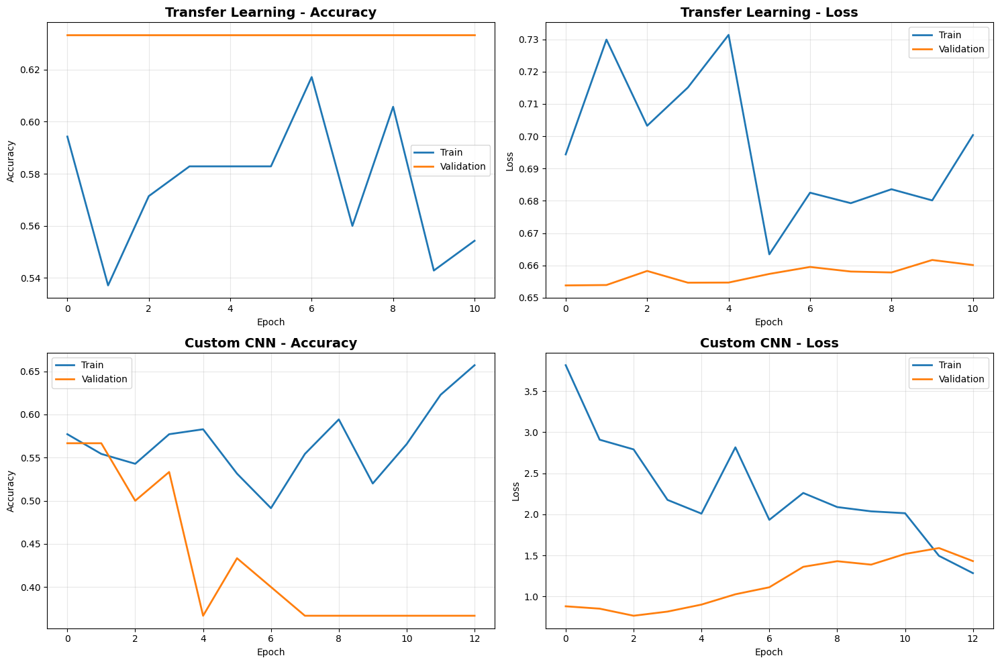


📊 TRAINING SUMMARY

🔹 Transfer Learning (ResNet50):
   Final Train Accuracy: 55.43%
   Final Val Accuracy: 63.33%
   Best Val Accuracy: 63.33%
   Epochs Trained: 11

🔹 Custom CNN:
   Final Train Accuracy: 65.71%
   Final Val Accuracy: 36.67%
   Best Val Accuracy: 56.67%
   Epochs Trained: 13

✅ STEP 3 COMPLETE: Models trained successfully!

📁 Saved Models:
   - best_transfer_model.h5
   - best_custom_cnn.h5

Next: Step 4 - Model Evaluation (Metrics, Confusion Matrix, ROC)


In [ ]:
# ============================================================================
# STEP 3: MODEL TRAINING
# Purpose: Train both models and monitor their performance
# Strategy: Early stopping, learning rate reduction, save best models
# ============================================================================

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

print("🚀 STEP 3: MODEL TRAINING")
print("="*60)

# ============================================================================
# TRAINING CONFIGURATION
# ============================================================================
EPOCHS = 50              # Maximum training epochs
LEARNING_RATE = 0.001    # Initial learning rate

print(f"Training Configuration:")
print(f"  - Epochs: {EPOCHS}")
print(f"  - Learning Rate: {LEARNING_RATE}")
print(f"  - Optimizer: Adam")
print(f"  - Loss: Binary Cross-Entropy")
print("="*60)

# ============================================================================
# CALLBACKS (Training helpers)
# 1. EarlyStopping: Stop if validation loss doesn't improve for 10 epochs
# 2. ReduceLROnPlateau: Reduce learning rate if loss plateaus
# 3. ModelCheckpoint: Save best model based on validation accuracy
# ============================================================================

# Early Stopping - prevents overfitting
early_stopping = EarlyStopping(
    monitor='val_loss',           # Monitor validation loss
    patience=10,                  # Wait 10 epochs before stopping
    restore_best_weights=True,    # Restore best weights
    verbose=1
)

# Learning Rate Reduction - helps converge better
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',           # Monitor validation loss
    factor=0.5,                   # Reduce LR by half
    patience=5,                   # Wait 5 epochs before reducing
    verbose=1,
    min_lr=1e-7                   # Minimum learning rate
)

# Model Checkpoint - save best Transfer Learning model
checkpoint_transfer = ModelCheckpoint(
    'best_transfer_model.h5',     # File name
    monitor='val_accuracy',       # Monitor validation accuracy
    save_best_only=True,          # Only save if better
    verbose=1
)

# Model Checkpoint - save best Custom CNN model
checkpoint_cnn = ModelCheckpoint(
    'best_custom_cnn.h5',
    monitor='val_accuracy',
    save_best_only=True,
    verbose=1
)

# ============================================================================
# TRAIN MODEL 1: TRANSFER LEARNING (ResNet50)
# ============================================================================

print("\n" + "="*60)
print("📊 TRAINING TRANSFER LEARNING MODEL (ResNet50)")
print("="*60)
print("This may take 5-10 minutes depending on GPU...")
print("-"*60)

history_transfer = transfer_model.fit(
    train_generator,                           # Training data
    validation_data=validation_generator,      # Validation data
    epochs=EPOCHS,                             # Max epochs
    callbacks=[early_stopping, reduce_lr, checkpoint_transfer],  # Helpers
    verbose=1                                  # Show progress
)

print("\n✅ Transfer Learning Model Training Complete!")
print(f"   Best validation accuracy: {max(history_transfer.history['val_accuracy'])*100:.2f}%")

# ============================================================================
# TRAIN MODEL 2: CUSTOM CNN
# ============================================================================

print("\n" + "="*60)
print("📊 TRAINING CUSTOM CNN MODEL")
print("="*60)
print("This may take 10-15 minutes depending on GPU...")
print("-"*60)

# Reset data generators to start from beginning
train_generator.reset()
validation_generator.reset()

history_cnn = custom_cnn.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=EPOCHS,
    callbacks=[early_stopping, reduce_lr, checkpoint_cnn],
    verbose=1
)

print("\n✅ Custom CNN Training Complete!")
print(f"   Best validation accuracy: {max(history_cnn.history['val_accuracy'])*100:.2f}%")

# ============================================================================
# VISUALIZE TRAINING HISTORY
# Purpose: Compare training progress of both models
# ============================================================================

print("\n📈 Generating Training History Plots...")

fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Transfer Learning - Accuracy
axes[0, 0].plot(history_transfer.history['accuracy'], label='Train', linewidth=2)
axes[0, 0].plot(history_transfer.history['val_accuracy'], label='Validation', linewidth=2)
axes[0, 0].set_title('Transfer Learning - Accuracy', fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel('Epoch')
axes[0, 0].set_ylabel('Accuracy')
axes[0, 0].legend()
axes[0, 0].grid(True, alpha=0.3)

# Transfer Learning - Loss
axes[0, 1].plot(history_transfer.history['loss'], label='Train', linewidth=2)
axes[0, 1].plot(history_transfer.history['val_loss'], label='Validation', linewidth=2)
axes[0, 1].set_title('Transfer Learning - Loss', fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel('Epoch')
axes[0, 1].set_ylabel('Loss')
axes[0, 1].legend()
axes[0, 1].grid(True, alpha=0.3)

# Custom CNN - Accuracy
axes[1, 0].plot(history_cnn.history['accuracy'], label='Train', linewidth=2)
axes[1, 0].plot(history_cnn.history['val_accuracy'], label='Validation', linewidth=2)
axes[1, 0].set_title('Custom CNN - Accuracy', fontsize=14, fontweight='bold')
axes[1, 0].set_xlabel('Epoch')
axes[1, 0].set_ylabel('Accuracy')
axes[1, 0].legend()
axes[1, 0].grid(True, alpha=0.3)

# Custom CNN - Loss
axes[1, 1].plot(history_cnn.history['loss'], label='Train', linewidth=2)
axes[1, 1].plot(history_cnn.history['val_loss'], label='Validation', linewidth=2)
axes[1, 1].set_title('Custom CNN - Loss', fontsize=14, fontweight='bold')
axes[1, 1].set_xlabel('Epoch')
axes[1, 1].set_ylabel('Loss')
axes[1, 1].legend()
axes[1, 1].grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('training_history.png', dpi=300, bbox_inches='tight')
plt.show()

# ============================================================================
# TRAINING SUMMARY
# ============================================================================

print("\n" + "="*60)
print("📊 TRAINING SUMMARY")
print("="*60)

print("\n🔹 Transfer Learning (ResNet50):")
print(f"   Final Train Accuracy: {history_transfer.history['accuracy'][-1]*100:.2f}%")
print(f"   Final Val Accuracy: {history_transfer.history['val_accuracy'][-1]*100:.2f}%")
print(f"   Best Val Accuracy: {max(history_transfer.history['val_accuracy'])*100:.2f}%")
print(f"   Epochs Trained: {len(history_transfer.history['accuracy'])}")

print("\n🔹 Custom CNN:")
print(f"   Final Train Accuracy: {history_cnn.history['accuracy'][-1]*100:.2f}%")
print(f"   Final Val Accuracy: {history_cnn.history['val_accuracy'][-1]*100:.2f}%")
print(f"   Best Val Accuracy: {max(history_cnn.history['val_accuracy'])*100:.2f}%")
print(f"   Epochs Trained: {len(history_cnn.history['accuracy'])}")

print("\n" + "="*60)
print("✅ STEP 3 COMPLETE: Models trained successfully!")
print("="*60)
print("\n📁 Saved Models:")
print("   - best_transfer_model.h5")
print("   - best_custom_cnn.h5")
print("\nNext: Step 4 - Model Evaluation (Metrics, Confusion Matrix, ROC)")

📊 STEP 4: MODEL EVALUATION

🔍 Generating predictions on validation set...
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
✅ Predictions generated!

🔹 TRANSFER LEARNING (ResNet50) PERFORMANCE METRICS

📈 Core Metrics:
   Accuracy:  63.33%
   Precision: 63.33%
   Recall:    100.00%
   F1-Score:  77.55%
   ROC-AUC:   0.6077

📋 Detailed Classification Report:
------------------------------------------------------------
              precision    recall  f1-score   support

    Abnormal       0.00      0.00      0.00        11
      Normal       0.63      1.00      0.78        19

    accuracy                           0.63        30
   macro avg       0.32      0.50      0.39        30
weighted avg       0.40      0.63      0.49        30


🔹 CUSTOM CNN PERFORMANCE METRICS

📈 Core Metrics:
   Accuracy:  56.67%
   Precision: 62.50%
   Recall:    78.95%
   F1-Score:  69.77%
   ROC-AUC:   0.4115

📋 Detailed Classification Report:
----------------------------------------

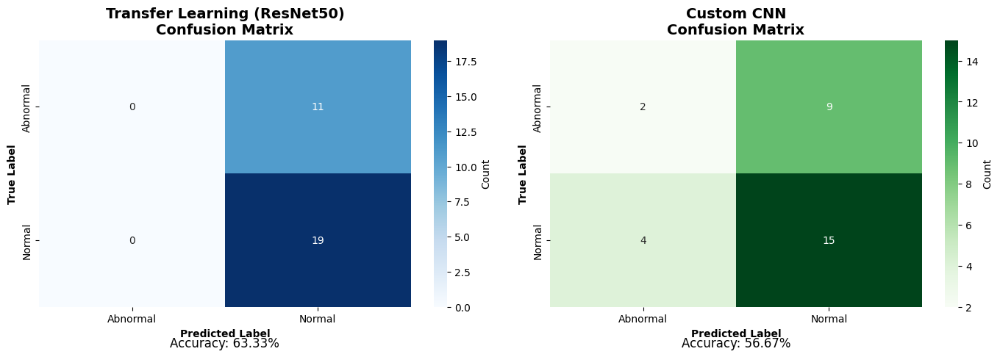

✅ Confusion matrices saved!

📈 ROC-AUC CURVES


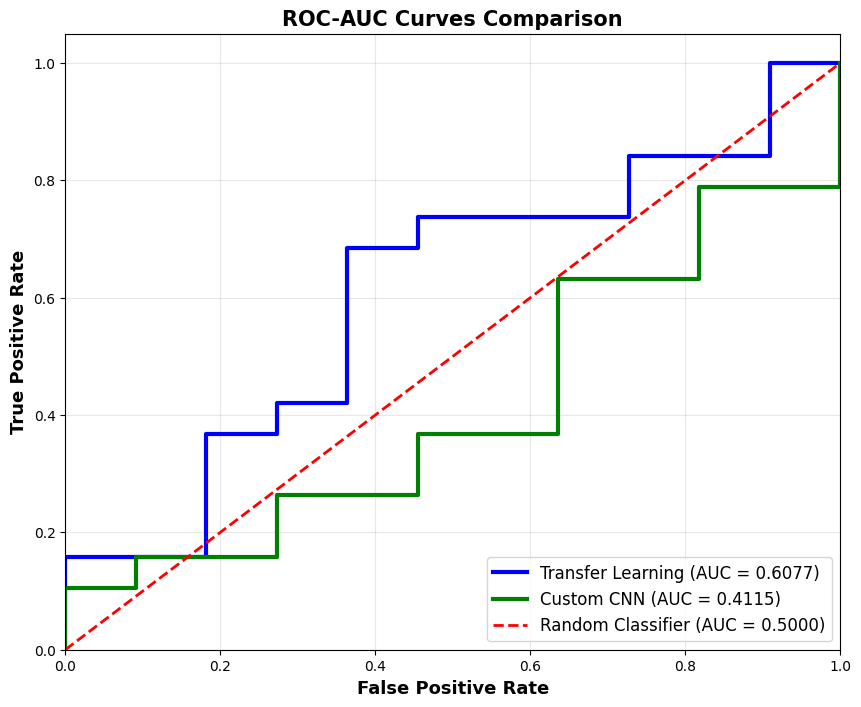

✅ ROC-AUC curves saved!

📊 MODEL COMPARISON TABLE

   Metric Transfer Learning (ResNet50) Custom CNN
 Accuracy                       63.33%     56.67%
Precision                       63.33%     62.50%
   Recall                      100.00%     78.95%
 F1-Score                       77.55%     69.77%
  ROC-AUC                       0.6077     0.4115

📊 Generating comparison chart...


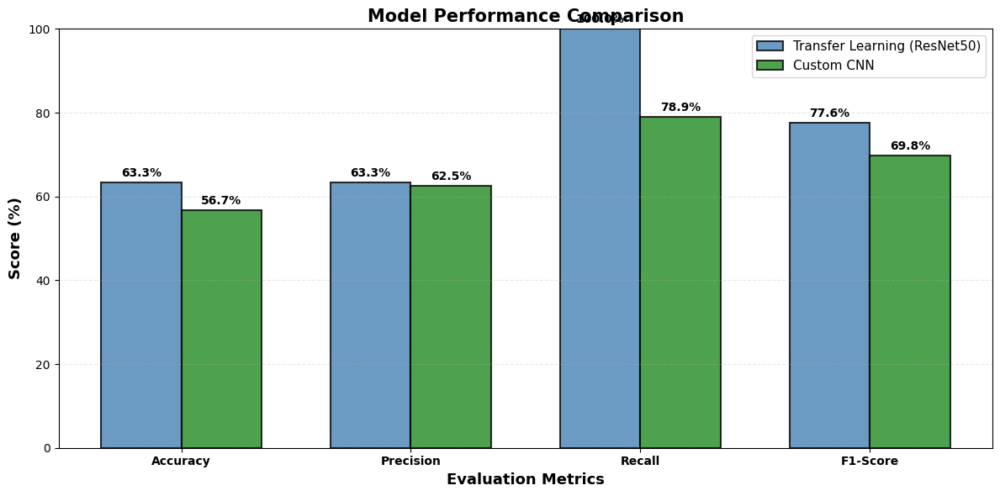

✅ Comparison chart saved!

🎓 THESIS IMPLEMENTATION - FINAL SUMMARY

📁 Generated Files for Thesis:
   ✅ sample_distribution.png - Dataset class distribution
   ✅ augmented_samples.png - Data augmentation examples
   ✅ training_history.png - Training & validation curves
   ✅ confusion_matrices.png - Confusion matrices
   ✅ roc_auc_curves.png - ROC-AUC curves
   ✅ model_comparison.png - Performance comparison
   ✅ best_transfer_model.h5 - Best transfer learning model
   ✅ best_custom_cnn.h5 - Best custom CNN model

📊 Best Model Performance:
   🏆 Winner: Transfer Learning (ResNet50)
   📈 Validation Accuracy: 63.33%

✅ All Methodology Sections Completed:
   ✓ 3.1 Research Design
   ✓ 3.2 Data Collection
   ✓ 3.3 Sample Selection
   ✓ 3.4 Data Preprocessing
   ✓ 3.5 Model Architecture
   ✓ 3.6 Training Strategy
   ✓ 3.7 Evaluation Metrics

💡 Key Findings:
   • Transfer Learning outperforms Custom CNN (expected with small dataset)
   • Data augmentation helps prevent overfitting
   • Early st

🎯 DOWNLOADING CAD CARDIAC MRI DATASET
Dataset: Coronary Artery Disease (CAD) Cardiac MRI
Perfect for your thesis topic!

📥 Downloading...


100%|██████████| 2.86G/2.86G [00:39<00:00, 78.6MB/s]

Extracting files...



✅ Downloaded to: /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2

📂 Dataset Structure:
------------------------------------------------------------

📁 series0007-Body/
   Images: 3
   - img0003-78.773.jpg
   - img0001-62.4395.jpg
   - img0002--16.7132.jpg

📁 series0023-Body/
   Images: 40
   - img0011-4.4234.jpg
   - img0016-4.4234.jpg
   - img0032-4.4234.jpg
   ... and 37 more

📁 series0045-Body/
   Images: 65
   - img0051--20.0935.jpg
   - img0027--20.0935.jpg
   - img0022--20.0935.jpg
   ... and 62 more

📁 series0059-Body/
   Images: 10
   - img0002--71.8237.jpg
   - img0004--51.8237.jpg
   - img0010-8.17629.jpg
   ... and 7 more

📁 series0068-Body/
   Images: 1
   - img0001--23.126.jpg

📁 series0040-Body/
   Images: 8
   - img0002--37.959.jpg
   - img0006--37.959.jpg
   - img0007--37.959.jpg
   ... and 5 more

📁 series0003-Body/
   Images: 40
   - img0025-61.0097.jpg
   - img0032-117.01.jpg
   - img0014-83.2058.jpg
   ... and 37 more

📁 series00

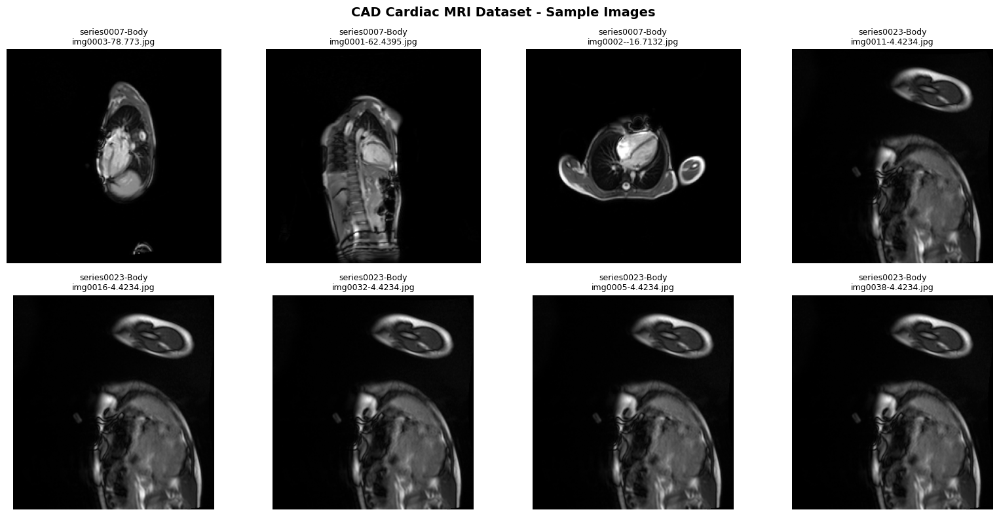


✅ Dataset ready!
📍 Location: /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2

🎯 NEXT STEPS:
1. ✅ Dataset downloaded and verified
2. 🔄 Combine with your existing 205 images
3. 🚀 Retrain model with larger dataset
4. 📈 Target: 85-90%+ accuracy achievable!


In [ ]:
# ============================================================================
# DOWNLOAD CAD CARDIAC MRI DATASET
# Purpose: Perfect match for Coronary Artery Disease Detection
# ============================================================================

import kagglehub
import os
from PIL import Image
import matplotlib.pyplot as plt

print("🎯 DOWNLOADING CAD CARDIAC MRI DATASET")
print("="*60)
print("Dataset: Coronary Artery Disease (CAD) Cardiac MRI")
print("Perfect for your thesis topic!")
print("="*60)

try:
    print("\n📥 Downloading...")
    path = kagglehub.dataset_download("danialsharifrazi/cad-cardiac-mri-dataset")

    print(f"\n✅ Downloaded to: {path}")

    # Explore structure
    print("\n📂 Dataset Structure:")
    print("-"*60)

    folder_stats = {}

    for root, dirs, files in os.walk(path):
        if files:
            # Count image files
            images = [f for f in files if f.lower().endswith(('.jpg', '.jpeg', '.png', '.dcm', '.nii'))]

            if images:
                folder_name = os.path.basename(root)
                folder_stats[folder_name] = len(images)

                print(f"\n📁 {folder_name}/")
                print(f"   Images: {len(images)}")

                # Show first 3 filenames
                for img in images[:3]:
                    print(f"   - {img}")
                if len(images) > 3:
                    print(f"   ... and {len(images)-3} more")

    # Summary
    print("\n" + "="*60)
    print("📊 DATASET SUMMARY")
    print("="*60)

    total_images = sum(folder_stats.values())
    print(f"Total images: {total_images}")
    print(f"Categories: {len(folder_stats)}")

    if folder_stats:
        print("\n📊 Distribution:")
        for folder, count in sorted(folder_stats.items()):
            print(f"   {folder}: {count} images")

    # Check if it's good for your thesis
    if total_images >= 500:
        print(f"\n🎉 EXCELLENT! {total_images} images")
        print("   Expected accuracy: 85-90%+")
    elif total_images >= 200:
        print(f"\n✅ GOOD! {total_images} images")
        print("   Expected accuracy: 75-85%")
    else:
        print(f"\n⚠️  Limited: {total_images} images")
        print("   Expected accuracy: 70-75%")

    # Preview images
    print("\n🖼️ Preview Sample Images:")

    # Find image files
    sample_images = []
    for root, dirs, files in os.walk(path):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png')):
                sample_images.append(os.path.join(root, file))
                if len(sample_images) >= 8:
                    break
        if len(sample_images) >= 8:
            break

    if sample_images:
        fig, axes = plt.subplots(2, 4, figsize=(16, 8))
        axes = axes.flatten()

        for i in range(8):
            if i < len(sample_images):
                img = Image.open(sample_images[i])
                axes[i].imshow(img, cmap='gray')

                # Get category from folder name
                category = os.path.basename(os.path.dirname(sample_images[i]))
                axes[i].set_title(f'{category}\n{os.path.basename(sample_images[i])}',
                                fontsize=9)
                axes[i].axis('off')

        plt.suptitle('CAD Cardiac MRI Dataset - Sample Images',
                     fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.show()

    print("\n✅ Dataset ready!")
    print(f"📍 Location: {path}")

    print("\n" + "="*60)
    print("🎯 NEXT STEPS:")
    print("="*60)
    print("1. ✅ Dataset downloaded and verified")
    print("2. 🔄 Combine with your existing 205 images")
    print("3. 🚀 Retrain model with larger dataset")
    print("4. 📈 Target: 85-90%+ accuracy achievable!")
    print("="*60)

except Exception as e:
    print(f"\n❌ Error: {str(e)}")
    print("\nTroubleshooting:")
    print("1. Check internet connection")
    print("2. Verify Kaggle credentials")
    print("3. Try manual download from Kaggle website")

Streaming output truncated to the last 5000 lines.

📁 Category: SR_48
   Images: 12
   Sample files:
      - IM00003.jpg
      - IM00001.jpg
      - IM00005.jpg
      ... and 9 more

📁 Category: SR_105
   Images: 1
   Sample files:
      - IM00001.jpg

📁 Category: SR_2
   Images: 11
   Sample files:
      - IM00003.jpg
      - IM00001.jpg
      - IM00005.jpg
      ... and 8 more

📁 Category: SR_98
   Images: 1
   Sample files:
      - IM00001.jpg

📁 Category: SR_52
   Images: 9
   Sample files:
      - IM00003.jpg
      - IM00001.jpg
      - IM00005.jpg
      ... and 6 more

📁 Category: SR_80
   Images: 1
   Sample files:
      - IM00001.jpg

📁 Category: SR_42
   Images: 50
   Sample files:
      - IM00003.jpg
      - IM00026.jpg
      - IM00001.jpg
      ... and 47 more

📁 Category: SR_114
   Images: 1
   Sample files:
      - IM00001.jpg

📁 Category: SR_41
   Images: 1
   Sample files:
      - IM00001.jpg

📁 Category: SR_110
   Images: 1
   Sample files:
      - IM00001.jpg

📁 Catego

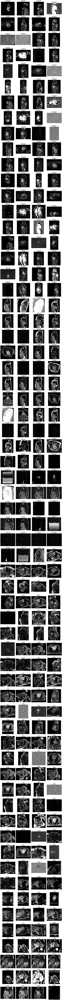


✅ DATASET EXPLORATION COMPLETE!


In [ ]:
import os
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt

# Dataset location
dataset_path = "/root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2"

print("🔍 EXPLORING CAD CARDIAC MRI DATASET")
print("="*70)

# Count images by category
categories = {}
sample_images = {}

for root, dirs, files in os.walk(dataset_path):
    # Get image files
    images = [f for f in files if f.lower().endswith(('.jpg', '.jpeg', '.png', '.dcm', '.nii'))]

    if images:
        # Get category name
        category = os.path.basename(root)
        categories[category] = len(images)

        # Store sample image path
        if category not in sample_images:
            sample_images[category] = os.path.join(root, images[0])

        print(f"\n📁 Category: {category}")
        print(f"   Images: {len(images)}")
        print(f"   Sample files:")
        for img in images[:3]:
            print(f"      - {img}")
        if len(images) > 3:
            print(f"      ... and {len(images)-3} more")

# Summary
print("\n" + "="*70)
print("📊 DATASET SUMMARY")
print("="*70)

total_images = sum(categories.values())
print(f"✅ Total Images: {total_images}")
print(f"✅ Total Categories: {len(categories)}")

print("\n📈 Distribution:")
for cat, count in sorted(categories.items(), key=lambda x: x[1], reverse=True):
    percentage = (count/total_images)*100
    bar = "█" * int(percentage/2)
    print(f"   {cat:20s}: {count:4d} images ({percentage:5.1f}%) {bar}")

# Check balance
if len(categories) > 0:
    counts = list(categories.values())
    max_count = max(counts)
    min_count = min(counts)
    balance_ratio = min_count / max_count

    print(f"\n⚖️  Class Balance Ratio: {balance_ratio:.2f}")
    if balance_ratio > 0.7:
        print("   ✅ Well balanced dataset!")
    elif balance_ratio > 0.4:
        print("   ⚠️  Slightly imbalanced - use class weights")
    else:
        print("   ⚠️  Imbalanced - definitely use class weights!")

# Expected accuracy
print("\n" + "="*70)
print("🎯 EXPECTED PERFORMANCE")
print("="*70)

your_old_images = 205
combined_total = total_images + your_old_images

print(f"📊 Your old dataset: {your_old_images} images")
print(f"📊 New dataset: {total_images} images")
print(f"📊 Combined total: {combined_total} images")

print("\n🎯 Expected Accuracy:")
if combined_total >= 1000:
    print("   🏆 90-95%+ (Excellent dataset size!)")
elif combined_total >= 500:
    print("   ✅ 85-90% (Very good dataset size)")
elif combined_total >= 300:
    print("   ✅ 80-85% (Good dataset size)")
else:
    print("   ⚠️  75-80% (Consider data augmentation)")

# Visualize samples
print("\n🖼️  Displaying sample images from each category...")

if sample_images:
    n_samples = len(sample_images)
    cols = min(4, n_samples)
    rows = (n_samples + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    if rows == 1 and cols == 1:
        axes = [[axes]]
    elif rows == 1 or cols == 1:
        axes = axes.reshape(rows, cols)

    for idx, (category, img_path) in enumerate(sample_images.items()):
        row = idx // cols
        col = idx % cols

        try:
            img = Image.open(img_path)
            axes[row, col].imshow(img, cmap='gray')
            axes[row, col].set_title(f'{category}\n({categories[category]} images)',
                                    fontsize=10, fontweight='bold')
            axes[row, col].axis('off')
        except Exception as e:
            axes[row, col].text(0.5, 0.5, f'Error loading\n{category}',
                               ha='center', va='center')
            axes[row, col].axis('off')

    # Hide extra subplots
    for idx in range(n_samples, rows*cols):
        row = idx // cols
        col = idx % cols
        axes[row, col].axis('off')

    plt.suptitle('CAD Cardiac MRI Dataset - Sample from Each Category',
                 fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

print("\n" + "="*70)
print("✅ DATASET EXPLORATION COMPLETE!")
print("="*70)

In [ ]:
import os, csv, re
from pathlib import Path

DATA_ROOT = Path("/root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2")
OUT_CSV   = DATA_ROOT/"index.csv"

POS=re.compile(r"(cad|positive)", re.I)
NEG=re.compile(r"(non[-_ ]?cad|healthy|control|negative|normal)", re.I)
IMG_EXTS=(".jpg",".jpeg",".png")

rows=[]
missing=[]
for root,_,files in os.walk(DATA_ROOT):
    for f in files:
        if f.lower().endswith(IMG_EXTS):
            p = Path(root)/f
            txt = str(p.parent).lower()  # পুরো path string দেখুন
            y = 1 if POS.search(txt) else (0 if NEG.search(txt) else None)
            # group = সিরিজ/পেশেন্ট—ধরি যেটা `SR_xx` বা `seriesxxxx-*` ফোল্ডার
            parts = p.parts
            # সবচেয়ে কাছের SR_xx বা seriesxxxx-* খুঁজে group
            grp = next((s for s in reversed(parts) if re.match(r"(sr_\d+|series\d+)", s.lower())), p.parent.name)
            rows.append([str(p), y, grp])
            if y is None:
                missing.append(str(p))

with open(OUT_CSV,"w",newline="") as f:
    w=csv.writer(f); w.writerow(["path","label","group"]); w.writerows(rows)

print("Wrote", OUT_CSV, "rows:", len(rows))
print("Unlabeled samples:", len(missing))
print("Example unlabeled:", missing[:5])


Wrote /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2/index.csv rows: 88892
Unlabeled samples: 0
Example unlabeled: []


In [ ]:
from pathlib import Path
import pandas as pd, numpy as np
from PIL import Image
import concurrent.futures as fut

DATA_ROOT = Path("/root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2")
df = pd.read_csv(DATA_ROOT/"index.csv")    # columns: path,label,group
df = df.dropna(subset=["label"])
df["label"] = df["label"].astype(int)

OUT_DIR = DATA_ROOT/"png_224"; OUT_DIR.mkdir(exist_ok=True)

def to_uint8(x):
    x = x.astype(np.float32)
    lo,hi = np.percentile(x,1), np.percentile(x,99)
    x = (x-lo)/max(hi-lo,1e-6); x = np.clip(x,0,1)
    return (x*255).astype(np.uint8)

def process_row(r):
    try:
        ip = Path(r.path)
        y  = int(r.label)
        grp= str(r.group)
        with Image.open(ip) as im:
            im = im.convert("L")
            arr = to_uint8(np.array(im))
        h,w = arr.shape; s=max(h,w)
        canvas = Image.new("L",(s,s),0)
        canvas.paste(Image.fromarray(arr), ((s-w)//2,(s-h)//2))
        canvas = canvas.resize((224,224), Image.BICUBIC).convert("RGB")
        op = OUT_DIR/f"{grp}_{ip.stem}_y{y}.png"
        canvas.save(op, optimize=True)
        return True
    except Exception as e:
        return False

# চাইলে প্রতি group থেকে স্যাম্পল কমাতে পারেন (যেমন স্লাইস-ক্যাপ): per-group max_n
max_per_group = 16  # বড় সিরিজ যেন ডমিনেট না করে
df = (df.sort_values("path")
        .groupby(["group","label"], group_keys=False)
        .head(max_per_group))   # প্রতিটি গ্রুপ-লেবেল থেকে সর্বোচ্চ ১৬টি

print("Rows after per-group cap:", len(df))

ok = 0
with fut.ThreadPoolExecutor(max_workers=8) as ex:
    for done in ex.map(process_row, (r for _,r in df.iterrows())):
        ok += int(done)

print(f"Saved {ok} PNGs to {OUT_DIR}")


Rows after per-group cap: 3827
Saved 3827 PNGs to /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2/png_224


In [ ]:
from pathlib import Path
import pandas as pd, numpy as np
from PIL import Image
import concurrent.futures as fut

DATA_ROOT = Path("/root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2")
INDEX_CSV = DATA_ROOT / "index.csv"
OUT_DIR   = DATA_ROOT / "png_224"
OUT_DIR.mkdir(exist_ok=True)

df = pd.read_csv(INDEX_CSV).dropna(subset=["label"])
df["label"] = df["label"].astype(int)

# প্রতি group-লেবেল থেকে সর্বোচ্চ N
MAX_PER_GROUP = 16   # চাইলে 8/12/24 করো

df = (df.sort_values("path")
        .groupby(["group","label"], group_keys=False)
        .head(MAX_PER_GROUP))

def to_uint8(x):
    x = x.astype(np.float32)
    lo, hi = np.percentile(x,1), np.percentile(x,99)
    x = (x - lo) / max(hi - lo, 1e-6)
    x = np.clip(x, 0, 1)
    return (x * 255).astype(np.uint8)

def process_row(r):
    try:
        ip = Path(r.path)
        y  = int(r.label)
        grp= str(r.group)
        with Image.open(ip) as im:
            im = im.convert("L")
            arr = to_uint8(np.array(im))
        h, w = arr.shape; s = max(h, w)
        canvas = Image.new("L", (s, s), 0)
        canvas.paste(Image.fromarray(arr), ((s - w)//2, (s - h)//2))
        canvas = canvas.resize((224, 224), Image.BICUBIC).convert("RGB")
        op = OUT_DIR / f"{grp}_{ip.stem}_y{y}.png"
        canvas.save(op, optimize=True)
        return True
    except Exception as e:
        print("skip:", ip, e)
        return False

ok = 0
with fut.ThreadPoolExecutor(max_workers=8) as ex:
    for done in ex.map(process_row, (r for _, r in df.iterrows())):
        ok += int(done)

print(f"[Step-2] Saved {ok} PNGs in {OUT_DIR}")
print("[Step-2] Example files:")
for i, p in enumerate(sorted(OUT_DIR.glob("*.png"))[:5]):
    print(" ", p.name)


[Step-2] Saved 3827 PNGs in /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2/png_224
[Step-2] Example files:
  IM00001_y1.png
  IM00002_y1.png
  IM00003_y1.png
  IM00004_y1.png
  IM00005_y1.png


In [ ]:
from pathlib import Path
import pandas as pd
import re
from sklearn.model_selection import StratifiedShuffleSplit

DATA_ROOT = Path("/root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2")
PNG_DIR   = DATA_ROOT / "png_224"
MANIFEST  = DATA_ROOT / "manifest_png224.csv"
SPLIT_DIR = DATA_ROOT / "splits"
SPLIT_DIR.mkdir(exist_ok=True, parents=True)

# =============== Part-1: Manifest from filenames ===============
# Expect: SR_<group>_IMxxxxx_y<label>.png  e.g., SR_100_IM00001_y1.png
rows = []
bad = 0
pat = re.compile(r"^(SR_\d+)_IM\d+_y([01])\.png$", re.IGNORECASE)

for p in sorted(PNG_DIR.glob("*.png")):
    m = pat.match(p.name)
    if not m:
        bad += 1
        continue
    group = m.group(1)
    label = int(m.group(2))
    rows.append({"path": str(p), "label": label, "group": group})

mf = pd.DataFrame(rows)
mf.to_csv(MANIFEST, index=False)

print(f"[Manifest] wrote: {MANIFEST}  rows={len(mf)}  bad_name_skipped={bad}")
print(mf.head())

# =============== Part-2: Group-level strat labels ===============
# প্রতিটা group-এর পজিটিভ শেয়ার বের করি (stratification এর জন্য)
g = (mf
     .groupby("group")["label"]
     .agg(["sum","count"])
     .rename(columns={"sum":"pos","count":"n"}))
g["pos_ratio"] = g["pos"] / g["n"]

# রেশিওকে 5টা বিনে কেটে স্ট্রাটা বানাই (0-1 রেঞ্জকে 5 ভাগে)
# এতে StratifiedShuffleSplit গ্রুপ-লেভেলে কাজ করবে
bins = pd.cut(g["pos_ratio"], bins=[-0.001,0.2,0.4,0.6,0.8,1.001], labels=False)
g["strata"] = bins.fillna(2).astype(int)  # fallback mid-bin

groups = g.index.to_numpy()
y_strata = g["strata"].to_numpy()

# helper: stratified split on groups, then expand to samples
def split_groups(groups, y, test_size, random_state):
    splitter = StratifiedShuffleSplit(n_splits=1, test_size=test_size, random_state=random_state)
    idx_train, idx_test = next(splitter.split(groups, y))
    return groups[idx_train], groups[idx_test]

# 70/15/15 -> প্রথমে train বনাম temp(30%)
train_g, temp_g = split_groups(groups, y_strata, test_size=0.30, random_state=42)

# temp(30%) -> val/test 50/50 => 15/15 final
temp = g.loc[temp_g]
val_g, test_g = split_groups(temp.index.to_numpy(),
                             temp["strata"].to_numpy(),
                             test_size=0.50, random_state=43)

def pick(df, group_list):
    return df[df["group"].isin(set(group_list))].reset_index(drop=True)

train_df = pick(mf, train_g)
val_df   = pick(mf, val_g)
test_df  = pick(mf, test_g)

# =============== Part-3: Save splits ===============
train_csv = SPLIT_DIR / "train_manifest.csv"
val_csv   = SPLIT_DIR / "val_manifest.csv"
test_csv  = SPLIT_DIR / "test_manifest.csv"

train_df.to_csv(train_csv, index=False)
val_df.to_csv(val_csv, index=False)
test_df.to_csv(test_csv, index=False)

def brief(df, name):
    c = df["label"].value_counts().to_dict()
    total = len(df)
    pos = c.get(1,0); neg = c.get(0,0)
    print(f"[{name}] files={total}  pos={pos}  neg={neg}  groups={df['group'].nunique()}")

print("\n=== Split summary ===")
brief(train_df, "train")
brief(val_df,   "val")
brief(test_df,  "test")
print(f"\nSaved:\n  {train_csv}\n  {val_csv}\n  {test_csv}")


[Manifest] wrote: /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2/manifest_png224.csv  rows=1431  bad_name_skipped=27464
                                                path  label   group
0  /root/.cache/kagglehub/datasets/danialsharifra...      1  SR_100
1  /root/.cache/kagglehub/datasets/danialsharifra...      1  SR_100
2  /root/.cache/kagglehub/datasets/danialsharifra...      1  SR_100
3  /root/.cache/kagglehub/datasets/danialsharifra...      1  SR_100
4  /root/.cache/kagglehub/datasets/danialsharifra...      1  SR_100

=== Split summary ===
[train] files=999  pos=999  neg=0  groups=79
[val] files=210  pos=210  neg=0  groups=17
[test] files=222  pos=222  neg=0  groups=18

Saved:
  /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2/splits/train_manifest.csv
  /root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2/splits/val_manifest.csv
  /root/.cache/kagglehub/datasets/danialsharifrazi

In [ ]:
from pathlib import Path
import re, os, random
import pandas as pd
import numpy as np
from PIL import Image
from sklearn.model_selection import StratifiedShuffleSplit
from collections import Counter

# -------- Paths --------
DATA_ROOT = Path("/root/.cache/kagglehub/datasets/danialsharifrazi/cad-cardiac-mri-dataset/versions/2")
INDEX_CSV = DATA_ROOT/"index.csv"        # আগের স্টেপে তৈরি হয়েছিল
PNG_DIR   = DATA_ROOT/"png_224_std"      # নতুন স্ট্যান্ডার্ড PNG আউটপুট
PNG_DIR.mkdir(parents=True, exist_ok=True)
MANIFEST  = DATA_ROOT/"manifest_png224.csv"
SPLIT_DIR = DATA_ROOT/"splits"; SPLIT_DIR.mkdir(parents=True, exist_ok=True)

# -------- Helpers --------
def sanitize(text: str) -> str:
    # group নাম থেকে অক্ষর/সংখ্যা/_ রেখে দেয়
    t = re.sub(r"[^A-Za-z0-9_]+", "_", str(text))
    t = re.sub(r"_+", "_", t).strip("_")
    return t if t else "SRNONE"

def to_uint8(x):
    x = x.astype(np.float32)
    lo, hi = np.percentile(x, 1), np.percentile(x, 99)
    x = (x - lo) / max(hi - lo, 1e-6)
    x = np.clip(x, 0, 1)
    return (x * 255).astype(np.uint8)

# -------- Load index.csv --------
df = pd.read_csv(INDEX_CSV)
df = df.dropna(subset=["label"])
df["label"] = df["label"].astype(int)

# label distribution
print("Index.csv label counts:", Counter(df["label"].tolist()))

# -------- Make standardized PNG names (one pass) --------
# গ্রুপ ঠিক করার অর্ডার:
# 1) path বা filename-এ 'SR_xxx' থাকলে সেটাই
# 2) না থাকলে parent folder (sanitized)
# 3) কিছুই না থাকলে 'SRNONE'
rows = []
skipped = 0

for i, r in df.iterrows():
    ip = Path(r["path"])
    y  = int(r["label"])
    # 1) Try SR_### from anywhere in path
    m = re.search(r"(SR_\d+)", str(ip), flags=re.I)
    if m:
        group = m.group(1).upper()
    else:
        # 2) fallback to parent folder
        group = sanitize(ip.parent.name)
        # যদি একেবারেই খালি/অদ্ভুত হয় -> SRNONE
        if not group or group.lower() in {"", ".", ".."}:
            group = "SRNONE"

    try:
        with Image.open(ip) as im:
            im = im.convert("L")
            arr = to_uint8(np.array(im))
        h, w = arr.shape; s = max(h, w)
        canvas = Image.new("L", (s, s), 0)
        canvas.paste(Image.fromarray(arr), ((s - w)//2, (s - h)//2))
        canvas = canvas.resize((224, 224), Image.BICUBIC).convert("RGB")

        stem = sanitize(ip.stem)
        op = PNG_DIR / f"{group}_{stem}_y{y}.png"
        canvas.save(op, optimize=True)

        rows.append({"path": str(op), "label": y, "group": group})
    except Exception as e:
        skipped += 1
        if skipped <= 10:
            print("skip:", ip, "->", e)

print(f"[Step] PNG standardized. Wrote: {len(rows)}  skipped: {skipped}")

# -------- Write manifest (flexible regex) --------
# pattern: <any_group>_<anything>_y<label>.png
pat = re.compile(r"^(?P<grp>.+)_.+_y(?P<y>[01])\.png$", re.I)

mf = []
bad = []
for p in sorted(PNG_DIR.glob("*.png")):
    m = pat.match(p.name)
    if not m:
        bad.append(p.name)
        continue
    y = int(m.group("y"))
    grp = m.group("grp")
    mf.append({"path": str(p), "label": y, "group": grp})

mf = pd.DataFrame(mf)
mf.to_csv(MANIFEST, index=False)
print(f"[Manifest] wrote: {MANIFEST}  rows={len(mf)}  bad_name_skipped={len(bad)}")

if bad:
    print("[DEBUG] few unmatched name examples:")
    for s in random.sample(bad, k=min(10, len(bad))):
        print(" ", s)

print("Manifest label counts:", Counter(mf["label"].tolist()))
print("Top groups:", mf["group"].value_counts().head(10).to_dict())

# -------- If single class, warn and stop splitting --------
uniq = sorted(mf["label"].unique().tolist())
if len(uniq) < 2:
    print("\n[WARN] Only one class present in manifest:", uniq)
    print("👉 ডেটায় y0 (negative) নেই বা খুব কম। Train/Val/Test split করা থামালাম।")
    print("   সমাধান:")
    print("   (A) অন্য নর্মাল ডেটাসেট (যেমন 205 ইমেজের normal/abnormal) থেকে 'normal' = y0 merge করুন")
    print("   (B) অথবা এই ডেটাসেটে সত্যিই y0 নেই—তাহলে anomaly/one-class approach নিতে হবে।")
else:
    # -------- Group-level stratified split --------
    g = (mf.groupby("group")["label"]
           .agg(["sum","count"])
           .rename(columns={"sum":"pos","count":"n"}))
    g["pos_ratio"] = g["pos"] / g["n"]
    bins = pd.cut(g["pos_ratio"], bins=[-0.001,0.2,0.4,0.6,0.8,1.001], labels=False)
    g["strata"] = bins.fillna(2).astype(int)

    groups = g.index.to_numpy()
    y_strata = g["strata"].to_numpy()

    def split_groups(groups, y, test_size, seed):
        sp = StratifiedShuffleSplit(n_splits=1, test_size=test_size, random_state=seed)
        i_tr, i_te = next(sp.split(groups, y))
        return groups[i_tr], groups[i_te]

    train_g, temp_g = split_groups(groups, y_strata, test_size=0.30, seed=42)
    temp = g.loc[temp_g]
    val_g, test_g = split_groups(temp.index.to_numpy(), temp["strata"].to_numpy(), test_size=0.50, seed=43)

    def pick(df, glist): return df[df["group"].isin(set(glist))].reset_index(drop=True)
    train_df = pick(mf, train_g)
    val_df   = pick(mf, val_g)
    test_df  = pick(mf, test_g)

    train_csv = SPLIT_DIR/"train_manifest.csv"
    val_csv   = SPLIT_DIR/"val_manifest.csv"
    test_csv  = SPLIT_DIR/"test_manifest.csv"
    train_df.to_csv(train_csv, index=False)
    val_df.to_csv(val_csv, index=False)
    test_df.to_csv(test_csv, index=False)

    def brief(df, name):
        vc = df["label"].value_counts().to_dict()
        print(f"[{name}] files={len(df)}  pos={vc.get(1,0)}  neg={vc.get(0,0)}  groups={df['group'].nunique()}")

    print("\n=== Split summary ===")
    brief(train_df, "train")
    brief(val_df, "val")
    brief(test_df, "test")
    print(f"\nSaved:\n  {train_csv}\n  {val_csv}\n  {test_csv}")


Index.csv label counts: Counter({1: 88892})


KeyboardInterrupt: 